## SST and Chlorophylla Anomaly Regression Analysis

In [1]:
from ocean_tools.io.readers import get_xarray_from_file
from ocean_tools.config.defaults import REGIONS
from ocean_tools.processing.data_prep import prepare_dataset_for_analysis, time_aggregator
from ocean_tools.processing.regression import get_regression_slopes
from ocean_tools.visualization.maps import plot_n_spatial_variable

import warnings
warnings.filterwarnings('ignore')

# Configuración inicial
REGION = REGIONS['cclme']
DATASETS = {
    'sst': "./data/exports/AQUA_MODIS_MONTHLY.2002-08-01_2024-11-01.nc",
    'chlor_a': "./data/exports/AQUA_MODIS_MONTHLY_CHLOR.2002-08-01_2024-11-01.nc"
}

exports_path = './data/exports/slopes'

In [2]:
ds_sst_raw = get_xarray_from_file(DATASETS['sst']).sel(time=slice('2002-08-01', '2024-07-01'))
ds_chlor_raw = get_xarray_from_file(DATASETS['chlor_a']).sel(time=slice('2002-08-01', '2024-07-01'))

ds_sst_anom_pos = prepare_dataset_for_analysis(ds_sst_raw.copy(), 'sst', use_anomalies=True, anomaly_transform='positive')
ds_sst_anom_neg = prepare_dataset_for_analysis(ds_sst_raw.copy(), 'sst', use_anomalies=True, anomaly_transform='negative')
ds_sst_anom_abs = prepare_dataset_for_analysis(ds_sst_raw.copy(), 'sst', use_anomalies=True, anomaly_transform='abs')

ds_chlor_anom_pos = prepare_dataset_for_analysis(ds_chlor_raw.copy(), 'chlor_a', use_anomalies=True, anomaly_transform='positive')
ds_chlor_anom_neg = prepare_dataset_for_analysis(ds_chlor_raw.copy(), 'chlor_a', use_anomalies=True, anomaly_transform='negative')
ds_chlor_anom_abs = prepare_dataset_for_analysis(ds_chlor_raw.copy(), 'chlor_a', use_anomalies=True, anomaly_transform='abs')

#### Full Period Linear Regression

In [3]:
# Calculate and store.
full_slope_sst_anom_pos = get_regression_slopes(ds_sst_anom_pos, 'sst', mode='full', step_name='SST Anom Pos', store=True, store_dir=exports_path, file_name='sot4_sst_anom_pos')
full_slope_sst_anom_neg = get_regression_slopes(ds_sst_anom_neg, 'sst', mode='full', step_name='SST Anom Neg', store=True, store_dir=exports_path, file_name='sot4_sst_anom_neg')
full_slope_chlor_anom_pos = get_regression_slopes(ds_chlor_anom_pos, 'chlor_a', mode='full', step_name='Chlor Anom Pos', store=True, store_dir=exports_path, file_name='sot4_chlor_anom_pos')
full_slope_chlor_anom_neg = get_regression_slopes(ds_chlor_anom_neg, 'chlor_a', mode='full', step_name='Chlor Anom Neg', store=True, store_dir=exports_path, file_name='sot4_chlor_anom_neg')

SST Anom Pos - 1%
SST Anom Pos - 2%
SST Anom Pos - 3%
SST Anom Pos - 4%
SST Anom Pos - 5%
SST Anom Pos - 6%
SST Anom Pos - 7%
SST Anom Pos - 8%
SST Anom Pos - 9%
SST Anom Pos - 10%
SST Anom Pos - 11%
SST Anom Pos - 12%
SST Anom Pos - 13%
SST Anom Pos - 14%
SST Anom Pos - 15%
SST Anom Pos - 16%
SST Anom Pos - 17%
SST Anom Pos - 18%
SST Anom Pos - 19%
SST Anom Pos - 20%
SST Anom Pos - 21%
SST Anom Pos - 22%
SST Anom Pos - 23%
SST Anom Pos - 24%
SST Anom Pos - 25%
SST Anom Pos - 26%
SST Anom Pos - 27%
SST Anom Pos - 28%
SST Anom Pos - 29%
SST Anom Pos - 30%
SST Anom Pos - 31%
SST Anom Pos - 32%
SST Anom Pos - 33%
SST Anom Pos - 34%
SST Anom Pos - 35%
SST Anom Pos - 36%
SST Anom Pos - 37%
SST Anom Pos - 38%
SST Anom Pos - 39%
SST Anom Pos - 40%
SST Anom Pos - 41%
SST Anom Pos - 42%
SST Anom Pos - 43%
SST Anom Pos - 44%
SST Anom Pos - 45%
SST Anom Pos - 46%
SST Anom Pos - 47%
SST Anom Pos - 48%
SST Anom Pos - 49%
SST Anom Pos - 50%
SST Anom Pos - 51%
SST Anom Pos - 52%
SST Anom Pos - 53%
SS

In [3]:
# If need to read them from files.
full_slope_sst_anom_pos = get_xarray_from_file(f"{exports_path}/sot4_sst_anom_pos_linreg_slope_full.nc")['slope']
full_slope_sst_anom_neg = get_xarray_from_file(f"{exports_path}/sot4_sst_anom_neg_linreg_slope_full.nc")['slope']
full_slope_chlor_anom_pos = get_xarray_from_file(f"{exports_path}/sot4_chlor_anom_pos_linreg_slope_full.nc")['slope']
full_slope_chlor_anom_neg = get_xarray_from_file(f"{exports_path}/sot4_chlor_anom_neg_linreg_slope_full.nc")['slope']

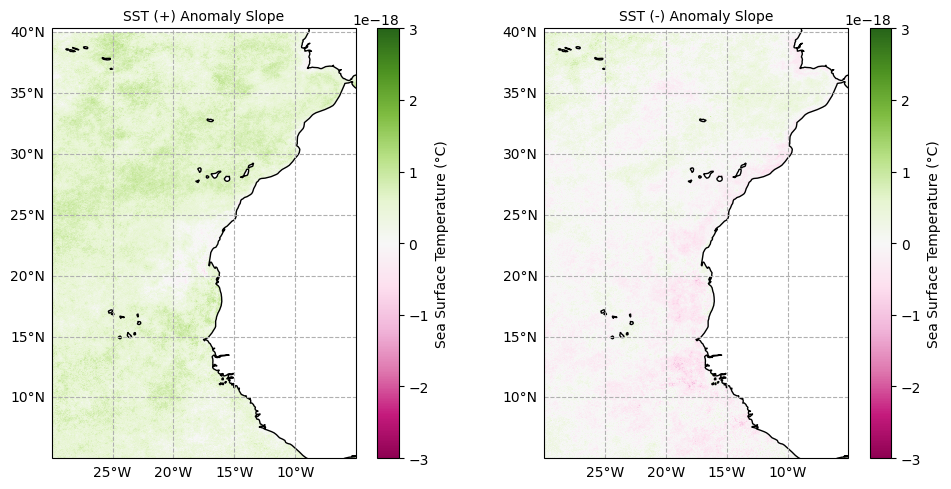

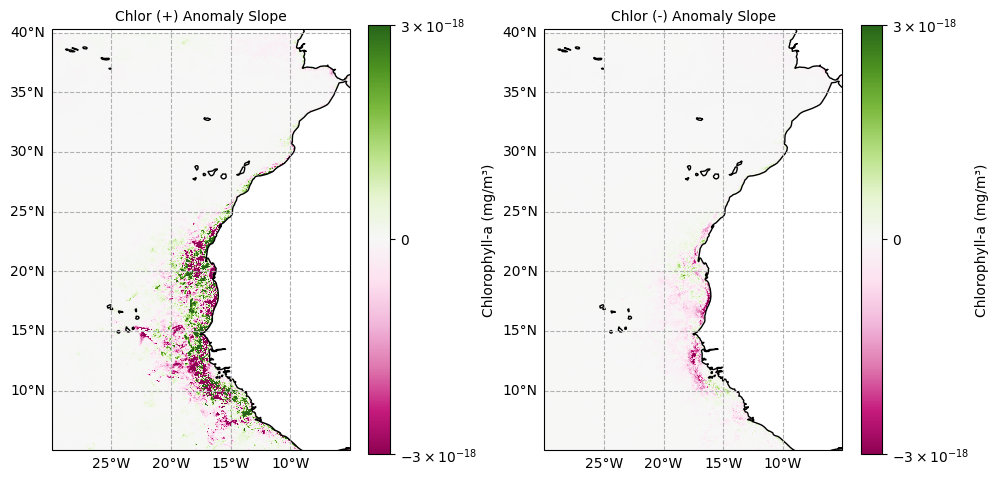

In [6]:
plot_n_spatial_variable(
    [full_slope_sst_anom_pos, full_slope_sst_anom_neg],
    ds_sst_anom_pos.lat,
    ds_sst_anom_pos.lon,
    nrows = 1,
    ncols = 2,
    i_width = 5,
    i_height = 5,
    clim = [-0.000000000000000003, 0.000000000000000003],
    cmap='PiYG',
    plot_label = 'Sea Surface Temperature (°C)', 
    titles = ['SST (+) Anomaly Slope', 'SST (-) Anomaly Slope'],
)

plot_n_spatial_variable(
    [full_slope_chlor_anom_pos, full_slope_chlor_anom_neg],
    ds_chlor_anom_pos.lat,
    ds_chlor_anom_pos.lon,
    nrows = 1,
    ncols = 2,
    i_width = 5,
    i_height = 5,
    clim = [-0.000000000000000003, 0.000000000000000003],
    cmap='PiYG',
    plot_label = 'Chlorophyll-a (mg/m³)',
    titles = ['Chlor (+) Anomaly Slope', 'Chlor (-) Anomaly Slope'],
    norm_mode='symlog'
)

#### Seasonal Linear Regression

In [6]:
seasonal_slope_sst_anom_pos = get_regression_slopes(ds_sst_anom_pos, 'sst', mode='seasonal', step_name='SST Anom Pos', store=True, store_dir=exports_path, file_name='sot4_sst_anom_pos')
seasonal_slope_sst_anom_neg = get_regression_slopes(ds_sst_anom_neg, 'sst', mode='seasonal', step_name='SST Anom Neg', store=True, store_dir=exports_path, file_name='sot4_sst_anom_neg')
seasonal_slope_chlor_anom_pos = get_regression_slopes(ds_chlor_anom_pos, 'chlor_a', mode='seasonal', step_name='Chlor Anom Pos', store=True, store_dir=exports_path, file_name='sot4_chlor_anom_pos')
seasonal_slope_chlor_anom_neg = get_regression_slopes(ds_chlor_anom_neg, 'chlor_a', mode='seasonal', step_name='Chlor Anom Neg', store=True, store_dir=exports_path, file_name='sot4_chlor_anom_neg')

SST Anom Pos - winter - 1%
SST Anom Pos - winter - 2%
SST Anom Pos - winter - 3%
SST Anom Pos - winter - 4%
SST Anom Pos - winter - 5%
SST Anom Pos - winter - 6%
SST Anom Pos - winter - 7%
SST Anom Pos - winter - 8%
SST Anom Pos - winter - 9%
SST Anom Pos - winter - 10%
SST Anom Pos - winter - 11%
SST Anom Pos - winter - 12%
SST Anom Pos - winter - 13%
SST Anom Pos - winter - 14%
SST Anom Pos - winter - 15%
SST Anom Pos - winter - 16%
SST Anom Pos - winter - 17%
SST Anom Pos - winter - 18%
SST Anom Pos - winter - 19%
SST Anom Pos - winter - 20%
SST Anom Pos - winter - 21%
SST Anom Pos - winter - 22%
SST Anom Pos - winter - 23%
SST Anom Pos - winter - 24%
SST Anom Pos - winter - 25%
SST Anom Pos - winter - 26%
SST Anom Pos - winter - 27%
SST Anom Pos - winter - 28%
SST Anom Pos - winter - 29%
SST Anom Pos - winter - 30%
SST Anom Pos - winter - 31%
SST Anom Pos - winter - 32%
SST Anom Pos - winter - 33%
SST Anom Pos - winter - 34%
SST Anom Pos - winter - 35%
SST Anom Pos - winter - 36%
S

In [10]:
# If need to read them from files.
seasonal_slope_sst_anom_pos = {}
for season in ['winter', 'spring', 'summer', 'autumn']:
    seasonal_slope_sst_anom_pos[season] = get_xarray_from_file(f"{exports_path}/sot4_sst_anom_pos_linreg_slope_seasonal_{season}.nc")['slope']

seasonal_slope_sst_anom_neg = {}
for season in ['winter', 'spring', 'summer', 'autumn']:
    seasonal_slope_sst_anom_neg[season] = get_xarray_from_file(f"{exports_path}/sot4_sst_anom_neg_linreg_slope_seasonal_{season}.nc")['slope']

seasonal_slope_chlor_anom_pos = {}
for season in ['winter', 'spring', 'summer', 'autumn']:
    seasonal_slope_chlor_anom_pos[season] = get_xarray_from_file(f"{exports_path}/sot4_chlor_anom_pos_linreg_slope_seasonal_{season}.nc")['slope']

seasonal_slope_chlor_anom_neg = {}
for season in ['winter', 'spring', 'summer', 'autumn']:
    seasonal_slope_chlor_anom_neg[season] = get_xarray_from_file(f"{exports_path}/sot4_chlor_anom_neg_linreg_slope_seasonal_{season}.nc")['slope']

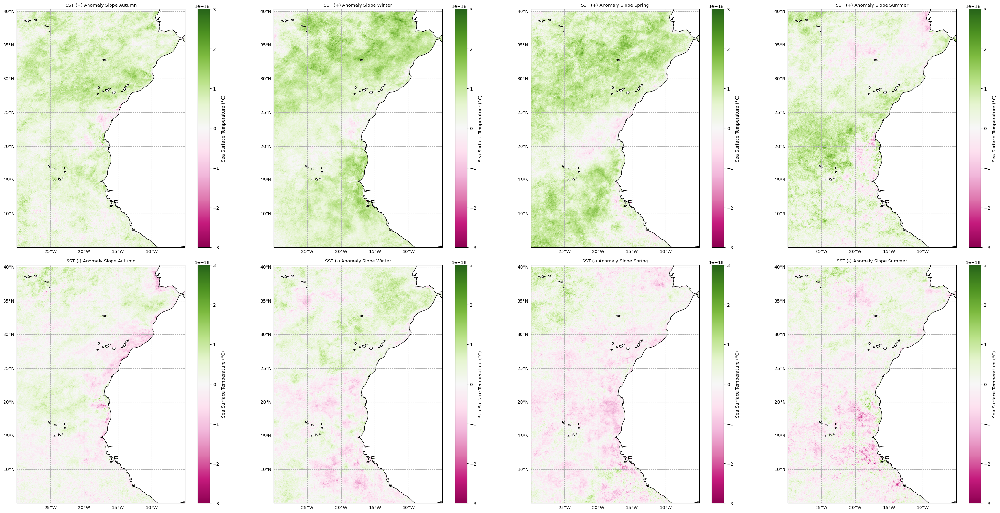

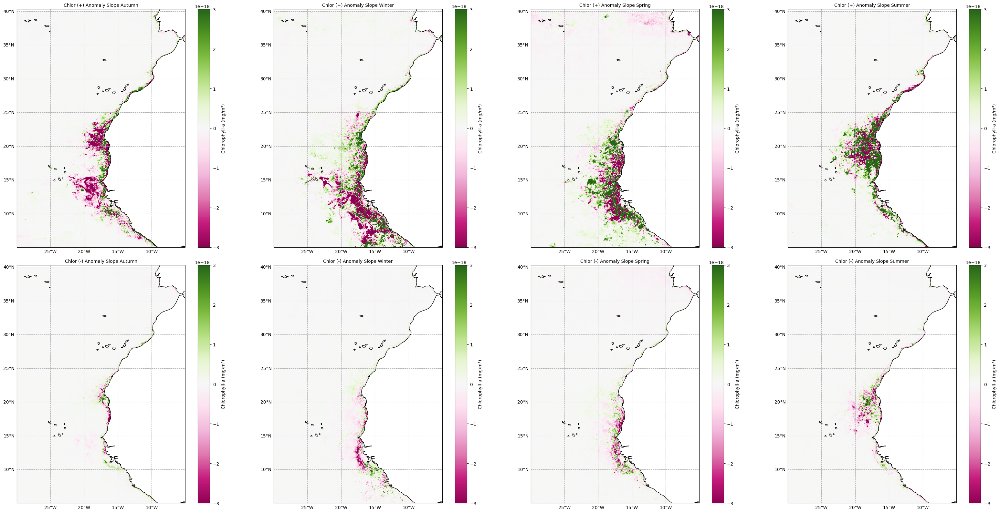

In [11]:
plot_n_spatial_variable(
    [
        seasonal_slope_sst_anom_pos['autumn'], seasonal_slope_sst_anom_pos['winter'], seasonal_slope_sst_anom_pos['spring'], seasonal_slope_sst_anom_pos['summer'],
        seasonal_slope_sst_anom_neg['autumn'], seasonal_slope_sst_anom_neg['winter'], seasonal_slope_sst_anom_neg['spring'], seasonal_slope_sst_anom_neg['summer']
    ],
    ds_sst_anom_pos.lat,
    ds_sst_anom_pos.lon,
    nrows = 2,
    ncols = 4,
    i_width = 8,
    i_height = 8,
    clim = [-0.000000000000000003, 0.000000000000000003],
    cmap='PiYG',
    plot_label = 'Sea Surface Temperature (°C)', 
    titles = [
        'SST (+) Anomaly Slope Autumn', 'SST (+) Anomaly Slope Winter', 'SST (+) Anomaly Slope Spring', 'SST (+) Anomaly Slope Summer',
        'SST (-) Anomaly Slope Autumn', 'SST (-) Anomaly Slope Winter', 'SST (-) Anomaly Slope Spring', 'SST (-) Anomaly Slope Summer'
    ]
)

plot_n_spatial_variable(
    [
        seasonal_slope_chlor_anom_pos['autumn'], seasonal_slope_chlor_anom_pos['winter'], seasonal_slope_chlor_anom_pos['spring'], seasonal_slope_chlor_anom_pos['summer'],
        seasonal_slope_chlor_anom_neg['autumn'], seasonal_slope_chlor_anom_neg['winter'], seasonal_slope_chlor_anom_neg['spring'], seasonal_slope_chlor_anom_neg['summer']
    ],
    ds_chlor_anom_pos.lat,
    ds_chlor_anom_pos.lon,
    nrows = 2,
    ncols = 4,
    i_width = 8,
    i_height = 8,
    clim = [-0.000000000000000003, 0.000000000000000003],
    cmap='PiYG',
    plot_label = 'Chlorophyll-a (mg/m³)', 
    titles = [
        'Chlor (+) Anomaly Slope Autumn', 'Chlor (+) Anomaly Slope Winter', 'Chlor (+) Anomaly Slope Spring', 'Chlor (+) Anomaly Slope Summer',
        'Chlor (-) Anomaly Slope Autumn', 'Chlor (-) Anomaly Slope Winter', 'Chlor (-) Anomaly Slope Spring', 'Chlor (-) Anomaly Slope Summer'
    ],
)

#### Monthly Linear Regression

In [9]:
monthly_slope_sst_anom_pos = get_regression_slopes(ds_sst_anom_pos, 'sst', mode='monthly', step_name='SST Anom Pos', store=True, store_dir=exports_path, file_name='sot4_sst_anom_pos')
monthly_slope_sst_anom_neg = get_regression_slopes(ds_sst_anom_neg, 'sst', mode='monthly', step_name='SST Anom Neg', store=True, store_dir=exports_path, file_name='sot4_sst_anom_neg')
monthly_slope_chlor_anom_pos = get_regression_slopes(ds_chlor_anom_pos, 'chlor_a', mode='monthly', step_name='Chlor Anom Pos', store=True, store_dir=exports_path, file_name='sot4_chlor_anom_pos')
monthly_slope_chlor_anom_neg = get_regression_slopes(ds_chlor_anom_neg, 'chlor_a', mode='monthly', step_name='Chlor Anom Neg', store=True, store_dir=exports_path, file_name='sot4_chlor_anom_neg')

SST Anom Pos - 1 - 1%
SST Anom Pos - 1 - 2%
SST Anom Pos - 1 - 3%
SST Anom Pos - 1 - 4%
SST Anom Pos - 1 - 5%
SST Anom Pos - 1 - 6%
SST Anom Pos - 1 - 7%
SST Anom Pos - 1 - 8%
SST Anom Pos - 1 - 9%
SST Anom Pos - 1 - 10%
SST Anom Pos - 1 - 11%
SST Anom Pos - 1 - 12%
SST Anom Pos - 1 - 13%
SST Anom Pos - 1 - 14%
SST Anom Pos - 1 - 15%
SST Anom Pos - 1 - 16%
SST Anom Pos - 1 - 17%
SST Anom Pos - 1 - 18%
SST Anom Pos - 1 - 19%
SST Anom Pos - 1 - 20%
SST Anom Pos - 1 - 21%
SST Anom Pos - 1 - 22%
SST Anom Pos - 1 - 23%
SST Anom Pos - 1 - 24%
SST Anom Pos - 1 - 25%
SST Anom Pos - 1 - 26%
SST Anom Pos - 1 - 27%
SST Anom Pos - 1 - 28%
SST Anom Pos - 1 - 29%
SST Anom Pos - 1 - 30%
SST Anom Pos - 1 - 31%
SST Anom Pos - 1 - 32%
SST Anom Pos - 1 - 33%
SST Anom Pos - 1 - 34%
SST Anom Pos - 1 - 35%
SST Anom Pos - 1 - 36%
SST Anom Pos - 1 - 37%
SST Anom Pos - 1 - 38%
SST Anom Pos - 1 - 39%
SST Anom Pos - 1 - 40%
SST Anom Pos - 1 - 41%
SST Anom Pos - 1 - 42%
SST Anom Pos - 1 - 43%
SST Anom Pos - 1 - 4

In [7]:
# If need to read them from files.
monthly_slope_sst_anom_pos = {}
for month in range(1, 13):
    monthly_slope_sst_anom_pos[month] = get_xarray_from_file(f"{exports_path}/sot4_sst_anom_pos_linreg_slope_monthly_m{month}.nc")['slope']

monthly_slope_sst_anom_neg = {}
for month in range(1, 13):
    monthly_slope_sst_anom_neg[month] = get_xarray_from_file(f"{exports_path}/sot4_sst_anom_neg_linreg_slope_monthly_m{month}.nc")['slope']

monthly_slope_chlor_anom_pos = {}
for month in range(1, 13):
    monthly_slope_chlor_anom_pos[month] = get_xarray_from_file(f"{exports_path}/sot4_chlor_anom_pos_linreg_slope_monthly_m{month}.nc")['slope']

monthly_slope_chlor_anom_neg = {}
for month in range(1, 13):
    monthly_slope_chlor_anom_neg[month] = get_xarray_from_file(f"{exports_path}/sot4_chlor_anom_neg_linreg_slope_monthly_m{month}.nc")['slope']

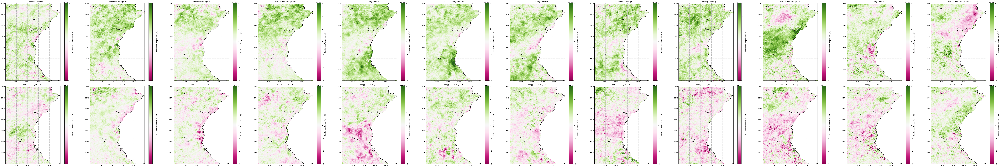

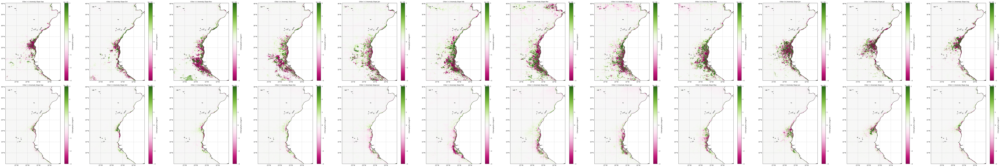

In [8]:
plot_n_spatial_variable(
    [
        monthly_slope_sst_anom_pos[9], monthly_slope_sst_anom_pos[10], monthly_slope_sst_anom_pos[11], 
        monthly_slope_sst_anom_pos[12], monthly_slope_sst_anom_pos[1], monthly_slope_sst_anom_pos[2], 
        monthly_slope_sst_anom_pos[3], monthly_slope_sst_anom_pos[4], monthly_slope_sst_anom_pos[5], 
        monthly_slope_sst_anom_pos[6], monthly_slope_sst_anom_pos[7], monthly_slope_sst_anom_pos[8],
        monthly_slope_sst_anom_neg[9], monthly_slope_sst_anom_neg[10], monthly_slope_sst_anom_neg[11], 
        monthly_slope_sst_anom_neg[12], monthly_slope_sst_anom_neg[1], monthly_slope_sst_anom_neg[2], 
        monthly_slope_sst_anom_neg[3], monthly_slope_sst_anom_neg[4], monthly_slope_sst_anom_neg[5], 
        monthly_slope_sst_anom_neg[6], monthly_slope_sst_anom_neg[7], monthly_slope_sst_anom_neg[8],
    ],
    ds_sst_anom_pos.lat,
    ds_sst_anom_pos.lon,
    nrows = 2,
    ncols = 12,
    i_width = 8,
    i_height = 8,
    clim = [-0.000000000000000003, 0.000000000000000003],
    cmap='PiYG',
    plot_label = 'Sea Surface Temperature (°C)',
    titles = [
        'SST (+) Anomaly Slope Sep', 'SST (+) Anomaly Slope Oct', 'SST (+) Anomaly Slope Nov',
        'SST (+) Anomaly Slope Dec', 'SST (+) Anomaly Slope Jan', 'SST (+) Anomaly Slope Feb',
        'SST (+) Anomaly Slope Mar', 'SST (+) Anomaly Slope Apr', 'SST (+) Anomaly Slope May',
        'SST (+) Anomaly Slope Jun', 'SST (+) Anomaly Slope Jul', 'SST (+) Anomaly Slope Aug',
        'SST (-) Anomaly Slope Sep', 'SST (-) Anomaly Slope Oct', 'SST (-) Anomaly Slope Nov',
        'SST (-) Anomaly Slope Dec', 'SST (-) Anomaly Slope Jan', 'SST (-) Anomaly Slope Feb',
        'SST (-) Anomaly Slope Mar', 'SST (-) Anomaly Slope Apr', 'SST (-) Anomaly Slope May',
        'SST (-) Anomaly Slope Jun', 'SST (-) Anomaly Slope Jul', 'SST (-) Anomaly Slope Aug'
    ]
)

plot_n_spatial_variable(
    [
        monthly_slope_chlor_anom_pos[9], monthly_slope_chlor_anom_pos[10], monthly_slope_chlor_anom_pos[11], 
        monthly_slope_chlor_anom_pos[12], monthly_slope_chlor_anom_pos[1], monthly_slope_chlor_anom_pos[2], 
        monthly_slope_chlor_anom_pos[3], monthly_slope_chlor_anom_pos[4], monthly_slope_chlor_anom_pos[5], 
        monthly_slope_chlor_anom_pos[6], monthly_slope_chlor_anom_pos[7], monthly_slope_chlor_anom_pos[8],
        monthly_slope_chlor_anom_neg[9], monthly_slope_chlor_anom_neg[10], monthly_slope_chlor_anom_neg[11], 
        monthly_slope_chlor_anom_neg[12], monthly_slope_chlor_anom_neg[1], monthly_slope_chlor_anom_neg[2], 
        monthly_slope_chlor_anom_neg[3], monthly_slope_chlor_anom_neg[4], monthly_slope_chlor_anom_neg[5], 
        monthly_slope_chlor_anom_neg[6], monthly_slope_chlor_anom_neg[7], monthly_slope_chlor_anom_neg[8],
    ],
    ds_chlor_anom_pos.lat,
    ds_chlor_anom_pos.lon,
    nrows = 2,
    ncols = 12,
    i_width = 8,
    i_height = 8,
    clim = [-0.000000000000000003, 0.000000000000000003],
    cmap='PiYG',
    plot_label = 'Chlorophyll-a (mg/m³)',
    titles = [
        'Chlor (+) Anomaly Slope Sep', 'Chlor (+) Anomaly Slope Oct', 'Chlor (+) Anomaly Slope Nov',
        'Chlor (+) Anomaly Slope Dec', 'Chlor (+) Anomaly Slope Jan', 'Chlor (+) Anomaly Slope Feb',
        'Chlor (+) Anomaly Slope Mar', 'Chlor (+) Anomaly Slope Apr', 'Chlor (+) Anomaly Slope May',
        'Chlor (+) Anomaly Slope Jun', 'Chlor (+) Anomaly Slope Jul', 'Chlor (+) Anomaly Slope Aug',
        'Chlor (-) Anomaly Slope Sep', 'Chlor (-) Anomaly Slope Oct', 'Chlor (-) Anomaly Slope Nov',
        'Chlor (-) Anomaly Slope Dec', 'Chlor (-) Anomaly Slope Jan', 'Chlor (-) Anomaly Slope Feb',
        'Chlor (-) Anomaly Slope Mar', 'Chlor (-) Anomaly Slope Apr', 'Chlor (-) Anomaly Slope May',
        'Chlor (-) Anomaly Slope Jun', 'Chlor (-) Anomaly Slope Jul', 'Chlor (-) Anomaly Slope Aug'
    ],
)